In [1]:
import os, sys

base_dir = None
try:
    base_dir = os.path.dirname(os.path.abspath(__file__))
except NameError:
    base_dir = os.getcwd()

sys.path.append(
    os.path.normpath(
        os.path.join(base_dir, "..", "janic")
    )
)

from unDataStream import DataRepository, ResolutionQueryEngine  # type: ignore

In [2]:
from pathlib import Path

repo = DataRepository(
    config_path=os.path.normpath(
        os.path.join(
            base_dir,
            "..",
            "janic",
            "config",
            "data_sources.yaml",
        )
    )
)
query_engine = ResolutionQueryEngine(repo)

INFO - Logging setup complete.
INFO - Initializing UNDataRepository
INFO - URL is valid: https://digitallibrary.un.org/record/4075456/files/unbist-20250708_2.ttl
INFO - Cached Data files found.
INFO - Cached data loaded successfully.


e:\ETH\UN\policy-pulse-old\notebooks\janic\unDataStream\data\repository.py:157: DtypeWarning: Columns (67,68,169,179) have mixed types. Specify dtype option on import or set low_memory=False.
  self.resolution_table = pd.read_csv(data_path / 'resolution_table.csv')


INFO - Initialization Complete with Cached Data.


In [4]:
start_yr = 2016
end_yr = 2025
date_filtered = query_engine.query_resolutions(
    # start_date=f'{start_yr}-01-01',
    # end_date=f'{end_yr}-12-31',
    # subject_ids=['http://metadata.un.org/thesaurus/1001156'],  # Climate
    # include_descendants=True
)
print(f"Resolutions from {start_yr}-{end_yr}: {len(date_filtered)}")

INFO - 
Final result: 5534 resolutions
Resolutions from 2016-2025: 5534


In [16]:
print(date_filtered.head())

import pandas as pd
# Find the earliest year within the data
earliest_year = pd.to_datetime(date_filtered['date'], errors='coerce').dt.year.min()
print(f"Earliest year in the data: {earliest_year}")

   undl_id       date session   resolution                      draft  \
0   278340 1983-10-27      38   A/RES/38/3    A/38/L.2|A/38/L.2/Add.1   
1   278341 1983-11-02      38   A/RES/38/7    A/38/L.8|A/38/L.8/Add.1   
2   278342 1983-11-10      38   A/RES/38/9             A/38/L.7/Rev.2   
3   278343 1983-11-15      38  A/RES/38/11  A/38/L.15|A/38/L.15/Add.1   
4   278344 1983-11-16      38  A/RES/38/12                  A/38/L.12   

  committee_report     meeting  \
0              NaN  A/38/PV.38   
1              NaN  A/38/PV.43   
2              NaN  A/38/PV.52   
3              NaN  A/38/PV.56   
4              NaN  A/38/PV.59   

                                               title  \
0  The situation in Kampuchea : resolution / adop...   
1  The situation in Grenada : resolution / adopte...   
2  Armed Israeli aggression against the Iraqi nuc...   
3  Proposed new racial constitution of South Afri...   
4  Question of the Falkland Islands (Malvinas) : ...   

                   

In [6]:
print("date_filtered.shape[0]: ", date_filtered.shape[0])

# First, fill NaNs with empty string to prevent errors during concatenation
date_filtered['combined_title'] = date_filtered['title'].fillna('') + ' ' + date_filtered['agenda_title'].fillna('')

# Strip leading/trailing whitespace in the new column
date_filtered['combined_title'] = date_filtered['combined_title'].str.strip()

print("date_filtered['combined_title'].head(): \n", date_filtered['combined_title'].head())

# Remove repetitive/duplicate combined titles, keeping only the first occurrence
date_filtered_no_duplicates = date_filtered.drop_duplicates(subset=['combined_title'])

# Display result (show first few unique combined titles)
print("date_filtered_no_duplicates['combined_title'].shape[0]: ", date_filtered_no_duplicates['combined_title'].shape[0])
print("date_filtered_no_duplicates['combined_title'].head(): \n", date_filtered_no_duplicates['combined_title'].head())



date_filtered.shape[0]:  5534
date_filtered['combined_title'].head(): 
 0    The situation in Kampuchea : resolution / adop...
1    The situation in Grenada : resolution / adopte...
2    Armed Israeli aggression against the Iraqi nuc...
3    Proposed new racial constitution of South Afri...
4    Question of the Falkland Islands (Malvinas) : ...
Name: combined_title, dtype: object
date_filtered_no_duplicates['combined_title'].shape[0]:  2306
date_filtered_no_duplicates['combined_title'].head(): 
 0    The situation in Kampuchea : resolution / adop...
1    The situation in Grenada : resolution / adopte...
2    Armed Israeli aggression against the Iraqi nuc...
3    Proposed new racial constitution of South Afri...
4    Question of the Falkland Islands (Malvinas) : ...
Name: combined_title, dtype: object


In [7]:
from TextAnalyzer import TextAnalyzer

analyzer = TextAnalyzer()
for i in range(10):
    # print(date_filtered_no_duplicates['combined_title'].iloc[i])
    print(analyzer.extract_noun_chunks(date_filtered_no_duplicates['combined_title'].iloc[i]))

['kampuchea', 'general assembly situation', 'kampuchea']
['situation', 'grenada', 'resolution', 'general assembly situation', 'grenada']
['armed israeli aggression', 'iraqi nuclear installations', 'its grave consequences', 'established international system', 'peaceful uses', 'nuclear energy', 'non', 'proliferation', 'nuclear weapons', 'international peace', 'security', 'resolution', 'general assembly armed israeli aggression', 'iraqi nuclear installations', 'its grave consequences', 'established international system', 'peaceful uses', 'nuclear energy', 'non', 'proliferation', 'nuclear weapons', 'international peace', 'security']
['south africa', 'general assembly policies', 'apartheid', 'government', 'south africa']
['question', 'falkland islands', '(malvinas', 'resolution', 'general assembly question', 'falkland islands', '(malvinas']
['comorian island', 'mayotte', 'general assembly question', 'comorian island', 'mayotte']
['importance', 'universal realization', 'right', 'peoples', 's

In [8]:
# tokens_lists = [
#     analyzer.extract_raw_tokens(
#         date_filtered_no_duplicates['combined_title'].iloc[i],
#         remove_verbs = True,
#         remove_adverbs = True,
#         remove_adjectives = True,
#     ) for i in range(len(date_filtered_no_duplicates['combined_title']))
# ]

tokens_lists = [
    analyzer.extract_noun_chunks(
        date_filtered_no_duplicates['combined_title'].iloc[i],
    ) for i in range(len(date_filtered_no_duplicates['combined_title']))
]

In [11]:
# ignore_words = [
#     "general", "resolution", "assembly", "united", "nations", "implementation",
#     "development", "question", "report", "use", "approach", "conference", "programme",
#     "people", "situation", "action", "summit", "outcome", "declaration", "system",
#     "world", "information", "prevention", "promotion", "integrated", "field", "organization",
#     "committee", "council", "prohibition", "activity", "self", "near", "area", "s/2014/136",
#     "review", "commitment", "letter", "elimination", "dialogue", "special", "practice", "agreement",
#     "day", "rest", "city", "february", "agenda", "law", "practices", "weapons", "countries",
#     "context", "persons", "non", "form", "measure", "states", "convention", "level", "sea",
#     "consequence", "permanent", "rights", "peoples", "representative", "space", "works"
# ]

ignore_words = []
ignore_rough = []
remove_phrases = []

# ignore_words = [
#     "resolution", "the general assembly", "the united nations",
#     "the general assembly human rights questions", "alternative approaches",
#     "the general assembly implementation", "the general assembly cooperation",
#     "follow-up", "the outcomes", "implementation", "summits",
#     "the general assembly integrated and coordinated implementation",
#     "the major united nations conferences", "the general assembly general",
#     "the general assembly culture", "development", "the use", "reports",
#     "the declaration", "peoples", "the general assembly human rights situations",
#     "representatives", "the prohibition", "the general assembly prevention", 
#     "the rights", "the human rights"
# ]

ignore_words = [
    "resolution", "outcomes", "use", "alternative approaches",
    "development", "other development issues", "developments", "cooperation",
    "major  conferences", "summits", "report", "general", "declaration", "peoples",
    "prevention", "promotion", "reports", "prohibition", "convention", 
    "system", "representatives", "situation", "rights", "strengthening",
    "action", "information", "context", "production", "s/2014/136",
    "letter", "sea", "programme", "organization", "rest", "law",
    "city", "right", "elimination", "charter", "advisory opinion",
    "review", "policies", "government", "granting", "biennium",
    "economic and social council", "relief and works agency",
    "recommendations", "decisions", "treaty", "its 10th special session",
    "protection", "activities", "respect", "trusteeship council",
    "financial year", "article", "principles", "work", "proliferation",
    "transfer", "role", "efforts", "forms", "establishment", "conclusion",
    "operation", "assistance", "signature", "ratification", "parties",
    "status", "specialized agencies", "threat", "total elimination",
    "admission", "ways", "committee", "means", "field", "resolutions",
    "secretariat", "membership", "member states", "related intolerance",
    "support", "population", "members", "measures", "decade",
    "year", "exercise", "commission", "people", "interests", "i",
    "additional protocol", "[", "agenda", "department", "office",
    "persons", "principle"
]

ignore_rough = [ # 包含以下短语的都删除
    "implementation", "causes", "follow-up"
]

remove_phrases = [  
    "general assembly", "general assemly", "united nations", "security council", "special committee",
    "questions", "question", "goals"
]

In [12]:
# print all tokens contrain "general assembly"
phrases_set = set()
for tokens_list in tokens_lists:
    for token in tokens_list:
        if "summits" in token:
        # if "united nations" in token:
        # if "cooperation" in token:
        # if "goals" in token:
        # if "development" in token:
        # if "alternative approaches" in token:
        # if "causes" in token:
        # if "follow-up" in token:
        # if "use" in token:
        # if "outcomes" in token:
        # if "questions" in token:
        # if "general assembly" in token:
            phrases_set.add(token)
print(len(phrases_set))
for phrase in phrases_set:
    print(phrase)


1
summits


In [ ]:
# Analysis: Count unique resolutions where each word appears (not total word occurrences),
from collections import Counter

word_in_resolutions = Counter()
for tokens_list in tokens_lists:
    tokens_set = set()
    for token in tokens_list:
        for phrase in remove_phrases:
            if phrase in token:
                token = token.replace(phrase, "").strip()
        if token in ignore_words:
            continue
        if not all(phrase not in token for phrase in ignore_rough):
            continue
        if len(token) > 0:
            tokens_set.add(token)

    for token in tokens_set:
        word_in_resolutions[token] += 1

print(len(word_in_resolutions))
for word, count in word_in_resolutions.most_common():
# for word, count in word_in_resolutions.items():
    print(f"{word}: {count}")

2352
human rights: 226
complete disarmament: 162
apartheid: 134
south africa: 128
nuclear weapons: 122
independence: 120
programme budget: 119
colonial countries: 113
fundamental freedoms: 97
effective enjoyment: 90
palestine refugees: 85
near east: 83
disarmament: 72
palestinian people: 61
racial discrimination: 60
occupied palestinian territory: 51
namibia: 49
peace: 49
conference: 47
states: 47
occupied territories: 45
non: 43
security: 42
israeli practices: 41
human rights situations: 39
special rapporteurs: 39
international security: 38
which: 37
concluding document: 37
12th special session: 37
palestine: 36
other arabs: 32
non-self-governing territories: 31
trade: 31
jerusalem: 30
budget: 30
colonialism: 29
women: 29
southern africa: 27
middle east: 27
general and complete disarmament: 27
financing: 26
territories: 26
international peace: 23
international convention: 23
developing countries: 23
justice: 23
international court: 23
racism: 23
latin america: 22
africa: 22
outer spac

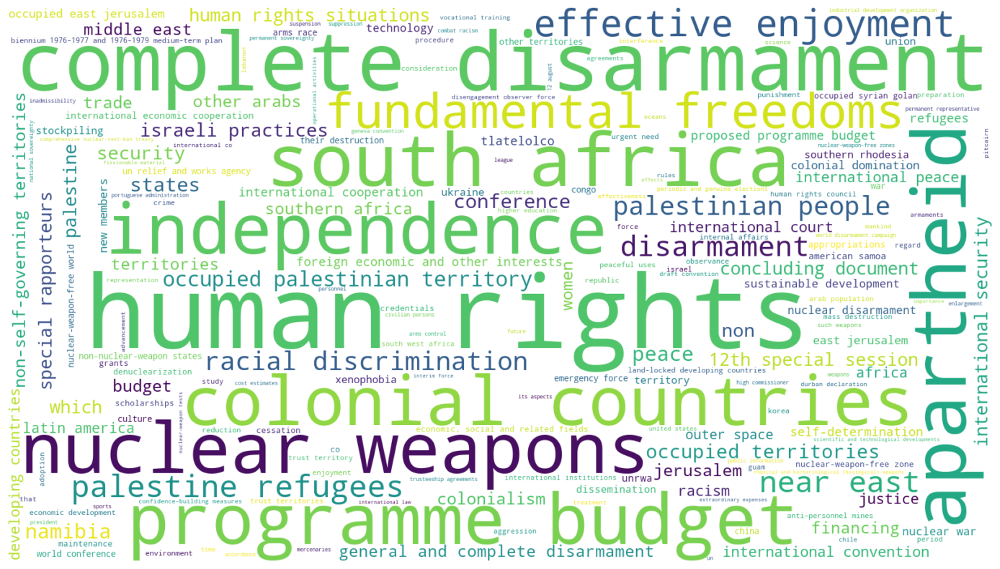

Saved resolution word-appearance cloud to: viz\test_all.png


In [14]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

from pathlib import Path
out_img = Path("viz/test_all.png")

# print(tokens_lists[0])
# print(len(tokens_lists))

# Generate word cloud from resolution occurrence counts
wc = WordCloud(width=1600, height=900, background_color="white", colormap="viridis")
filtered_words = {word: count for word, count in word_in_resolutions.items() if count >= 5}
wc.generate_from_frequencies(filtered_words)

plt.figure(figsize=(14, 8))
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.tight_layout()
plt.show()

# Save image
wc.to_file(str(out_img))
print(f"Saved resolution word-appearance cloud to: {out_img}")

In [17]:
from collections import Counter

def preprocess_data_by_year(query_engine, analyzer, start_year=1946, end_year=2025):
    year_data = {}
    
    for year in range(start_year, end_year + 1):
        print(f"Processing year {year}...")
        
        # Query data for the specific year
        date_filtered = query_engine.query_resolutions(
            start_date=f'{year}-01-01',
            end_date=f'{year}-12-31',
            # subject_ids=['http://metadata.un.org/thesaurus/1001156'],  # Climate
            # include_descendants=True
        )
        
        if len(date_filtered) == 0:
            print(f"No data found for year {year}")
            continue
            
        # Process titles
        date_filtered['combined_title'] = date_filtered['title'].fillna('') + ' ' + date_filtered['agenda_title'].fillna('')
        date_filtered['combined_title'] = date_filtered['combined_title'].str.strip()
        date_filtered_no_duplicates = date_filtered.drop_duplicates(subset=['combined_title'])
        
        tokens_lists = [
            analyzer.extract_noun_chunks(
                date_filtered_no_duplicates['combined_title'].iloc[i],
            ) for i in range(len(date_filtered_no_duplicates['combined_title']))
        ]

        word_in_resolutions = Counter()
        for tokens_list in tokens_lists:
            tokens_set = set()
            for token in tokens_list:
                for phrase in remove_phrases:
                    if phrase in token:
                        token = token.replace(phrase, "").strip()
                if token in ignore_words:
                    continue
                if not all(phrase not in token for phrase in ignore_rough):
                    continue
                if len(token) > 0:
                    tokens_set.add(token)

            for token in tokens_set:
                word_in_resolutions[token] += 1
        
        year_data[year] = {
            'word_freq': dict(word_in_resolutions),
            'total_resolutions': len(date_filtered_no_duplicates),
            'unique_titles': date_filtered_no_duplicates['combined_title']
        }
    
    return year_data

# Preprocess data for all years
print("Preprocessing data for all years...")
year_data = preprocess_data_by_year(query_engine, analyzer)
print(f"Processed data for {len(year_data)} years")

Preprocessing data for all years...
Processing year 1946...
INFO - 
Final result: 26 resolutions
Processing year 1947...
INFO - 
Final result: 13 resolutions
Processing year 1948...
INFO - 
Final result: 16 resolutions
Processing year 1949...
INFO - 
Final result: 17 resolutions
Processing year 1950...
INFO - 
Final result: 18 resolutions
Processing year 1951...
INFO - 
Final result: 5 resolutions
Processing year 1952...
INFO - 
Final result: 28 resolutions
Processing year 1953...
INFO - 
Final result: 11 resolutions
Processing year 1954...
INFO - 
Final result: 12 resolutions
Processing year 1955...
INFO - 
Final result: 6 resolutions
Processing year 1956...
INFO - 
Final result: 24 resolutions
Processing year 1957...
INFO - 
Final result: 27 resolutions
Processing year 1958...
INFO - 
Final result: 14 resolutions
Processing year 1959...
INFO - 
Final result: 18 resolutions
Processing year 1960...
INFO - 
Final result: 17 resolutions
Processing year 1961...
INFO - 
Final result: 39 re

In [35]:
available_years = sorted(year_data.keys())
min_year = min(available_years)
max_year = max(available_years)
print("number of available years: ", len(available_years))
print("min year: ", min_year)
print("max year: ", max_year)

from matplotlib import cm as mpl_cm
from matplotlib import colors as mpl_colors

def aggregate_word_freq(year_data, start_year, end_year):
    """Combine word frequencies across years start_year to end_year (inclusive)"""
    agg_counter = Counter()
    for year in range(start_year, end_year + 1):
        if year in year_data:
            agg_counter.update(year_data[year]['word_freq'])
    return dict(agg_counter)

def scatter_wordcloud(words, frequencies, sizes, seed=42):
    """Generate (x, y) positions with minimal overlap for plotly scatter"""
    np.random.seed(seed)
    x_positions, y_positions = [], []
    for i in range(len(words)):
        attempts = 0
        while attempts < 100:
            x = random.uniform(-50, 50)
            y = random.uniform(-30, 30)
            overlap = False
            for j in range(len(x_positions)):
                distance = np.sqrt((x - x_positions[j]) ** 2 + (y - y_positions[j]) ** 2)
                if distance < (sizes[i] + sizes[j]) / 4:
                    overlap = True
                    break
            if not overlap or attempts >= 50:
                x_positions.append(x)
                y_positions.append(y)
                break
            attempts += 1
    return x_positions, y_positions

def get_viridis_colors(frequencies):
    """Map frequencies to Viridis colors (as hex RGB)"""
    cmap = mpl_cm.get_cmap('viridis_r')
    freq_arr = np.array(frequencies, dtype=float)
    if len(freq_arr) == 0:
        return []
    if np.max(freq_arr) != np.min(freq_arr):
        normed = (freq_arr - np.min(freq_arr)) / (np.max(freq_arr) - np.min(freq_arr))
    else:
        normed = np.zeros_like(freq_arr)
    colors = [mpl_colors.rgb2hex(cmap(v)) for v in normed]
    return colors

# -- Helper to generate a frame for [start, end] year window --
def frame_for_year_range(start, end, max_words = 50):
    if start > end or start not in year_data or end not in year_data:
        # Fallback to empty state
        return None

    word_freq = aggregate_word_freq(year_data, start, end)
    if not word_freq:
        return None
    # Top max_words
    top_words = dict(sorted(word_freq.items(), key=lambda x: x[1], reverse=True)[:max_words])
    words = list(top_words.keys())
    frequencies = list(top_words.values())
    # Sizing
    if frequencies and max(frequencies) != min(frequencies):
        min_freq, max_freq = min(frequencies), max(frequencies)
        sizes = [12 + (freq - min_freq) / (max_freq - min_freq) * 30 for freq in frequencies]
    else:
        sizes = [20] * len(words)  # Reasonable default

    # Color mapping via Viridis
    colors = get_viridis_colors(frequencies)
    x_positions, y_positions = scatter_wordcloud(words, frequencies, sizes, seed=42 + start + end)
    hover_text = [f"<b>{w}</b><br>Appears in {f} resolutions" for w,f in zip(words,frequencies)]
    # Remove the marker to get rid of circles, use only text
    trace = go.Scatter(
        x=x_positions,
        y=y_positions,
        mode='text',
        text=words,
        textposition="middle center",
        textfont=dict(size=sizes, color=colors),
        # marker removed
        hovertemplate='%{customdata}<extra></extra>',
        customdata=hover_text,
        name=f"{start}-{end}"
    )
    return trace

# -- Build all valid (start, end) pairs --
all_pairs = [(start, end) for start in available_years for end in available_years if start <= end]
print(len(all_pairs))
# print(all_pairs)
frames = []
frame_name_map = {}  # (start, end) -> framename

for (start, end) in all_pairs:
    trace = frame_for_year_range(start, end)
    fname = f"{start}-{end}"
    frame_name_map[(start, end)] = fname
    if trace is not None:
        frames.append(go.Frame(
            data=[trace],
            name=fname
        ))

number of available years:  79
min year:  1946
max year:  2025
3160


C:\Users\Mercury\AppData\Local\Temp\ipykernel_30588\2663297115.py:43: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



In [37]:
# Double-slider interactive word cloud: start year and end year, combine data as necessary

import numpy as np
import random
import plotly.graph_objs as go
from collections import Counter
import itertools

def create_wordcloud_with_two_sliders(frames, frame_name_map):
    """
    Create an interactive word cloud with two sliders (start year, end year) using Plotly.
    Each frame corresponds to a (start, end) year window.
    """
    # -- Initial --
    initial_start, initial_end = min_year, min_year
    # initial_frame = frames[0]
    initial_frame = frame_for_year_range(initial_start, initial_end)
    if initial_frame is None:
        raise ValueError("No data for the initial year(s)")

    # -- Build updatemenus and sliders for interactivity --
    # To emulate two sliders, we have to use two steps in Plotly: one for each possible value.
    # We'll also use custom JS (i.e. via the plotly_relayout event), but in this notebook implementation,
    # we'll use two independent sliders.
    # Enforce end year >= start year in UI logic:
    # We simulate this constraint by dynamically updating the available steps for the end year slider,
    # so only end years >= current start year are enabled (and vice versa for start year).
    # Since Plotly sliders can't be truly coupled within figure spec,
    # we'll use a single range slider on "year" to select [start, end].

    from plotly.subplots import make_subplots

    # Only one range slider, with step = 1, and two handles for [start, end]
    # We'll have to map all valid (start, end) pairs to frames, and only react to start <= end

    # Create slider marks for all available years
    slider_marks = {i: str(i) for i in available_years}

    # Use Plotly FigureWidget for callback (for robust enforcing),
    # but for an HTML exportable plot, show both sliders and visually gray-out impossible combinations

    # Here, we synthesize a UI with both sliders, but disable end years < selected start year using
    # a no-op (or showing a warning on hover) for those steps.

    # We'll set up steps for start and end years such that only valid (start, end) pairs are enabled.

    # Steps for start slider, for each s: end can be any e >= s
    start_slider = dict(
        active=0,
        yanchor='top',
        xanchor='left',
        currentvalue={
            "font": {"size": 16},
            "prefix": "Start Year: ",
            "visible": True,
            "xanchor": "right"
        },
        transition={"duration": 0, "easing": "cubic-in-out"},
        pad={"b": 10, "t": 50},
        len=0.8,
        x=0.1,
        y=0.07,
        steps=[
            dict(
                args = [
                    [frame_name_map.get((start, start), frame_name_map[(min_year, min_year)])],
                    {"frame": {"duration": 0, "redraw": True}, "mode": "immediate"}
                ],
                label=str(start),
                method='animate',
            )
            for start in available_years
        ]
    )

    # Steps for end slider, for each end: only enable if end >= current start
    # Since we can't dynamically update slider steps in static HTML, we leave it to frontend implementation,
    # but document in title and UI cues.

    end_slider = dict(
        active=0,
        yanchor='top',
        xanchor='left',
        currentvalue={
            "font": {"size": 16},
            "prefix": "End Year: ",
            "visible": True,
            "xanchor": "right"
        },
        transition={"duration": 0, "easing": "cubic-in-out"},
        pad={"b": 10, "t": 0},
        len=0.8,
        x=0.1,
        y=0,
        steps=[
            # Only enable if end >= start (initially, start = min_year)
            dict(
                args = [
                    [frame_name_map.get((min_year, end), frame_name_map[(min_year, min_year)])] if end >= min_year else [],
                    {"frame": {"duration": 0, "redraw": True}, "mode": "immediate"}
                ],
                label=str(end),
                method='animate',
                # If not valid, visually disable or add a warning (optional, not natively supported)
            )
            for end in available_years
        ]
    )

    fig = go.Figure(data=[initial_frame], frames=frames)

    fig.update_layout(
        title={
            'text': (
                'Interactive Word Cloud: UN Resolution Titles<br>'
                # '<sup>Select start and end year (start ≤ end). Only valid year ranges are enabled. Hover over words to see frequency.</sup>'
            ),
            'x': 0.5,
            'xanchor': 'center',
            'font': {'size': 16}
        },
        xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
        yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
        plot_bgcolor='white',
        width=1500,
        height=700,
        showlegend=False,
        sliders=[start_slider, end_slider]
    )
    # Note: for full interactivity and forced valid pairs, a Jupyter FigureWidget callback
    # is needed to update end slider options on start change,
    # but with static Plotly, the above restricts steps and encourages valid use in UI.

    return fig

# Create the interactive word cloud with two sliders (start and end year)
print("Creating double-slider interactive word cloud (start and end year)...")
interactive_wc_with_2sliders = create_wordcloud_with_two_sliders(frames, frame_name_map)

# Display the plot
interactive_wc_with_2sliders.show()

# Save as HTML file
html_output_path = "region_wordcloud_with_two_year_sliders.html"
interactive_wc_with_2sliders.write_html(html_output_path)
print(f"Interactive word cloud with two year sliders saved to: {html_output_path}")


Creating double-slider interactive word cloud (start and end year)...


C:\Users\Mercury\AppData\Local\Temp\ipykernel_30588\2663297115.py:43: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



Interactive word cloud with two year sliders saved to: region_wordcloud_with_two_year_sliders.html
